## Task 4 - Exploratory Data Analysis - Terrorism



*  To Perform 'Exploratory Data Analysis' on dataset "Global Terrorism"
*   Trying to figure out the Hot-Zone of Terrorism 




## Author : Meet Vaddoriya

In [1]:
#import the important libraries
import pandas as pd
import numpy as np # linear algebra
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import plotly.express as px
import plotly.graph_objects as go
from collections import Counter
import seaborn as sns
%matplotlib inline


In [2]:
#read the dataset
df= pd.read_csv("globalterrorismdb_0718dist.csv", encoding = "ISO-8859-1")
df.head(10)

C:\Users\meet\anaconda3\envs\tensorflow--new\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
5,197001010002,1970,1,1,NaN,0,NaN,217,United States,1,...,"The Cairo Chief of Police, William Petersen, r...","""Police Chief Quits,"" Washington Post, January...","""Cairo Police Chief Quits; Decries Local 'Mili...","Christopher Hewitt, ""Political Violence and Te...",Hewitt Project,-9,-9,0,-9,NaN
6,197001020001,1970,1,2,NaN,0,NaN,218,Uruguay,3,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
7,197001020002,1970,1,2,NaN,0,NaN,217,United States,1,...,"Damages were estimated to be between $20,000-$...",Committee on Government Operations United Stat...,"Christopher Hewitt, ""Political Violence and Te...",NaN,Hewitt Project,-9,-9,0,-9,NaN
8,197001020003,1970,1,2,NaN,0,NaN,217,United States,1,...,The New Years Gang issue a communiqué to a loc...,"Tom Bates, ""Rads: The 1970 Bombing of the Army...","David Newman, Sandra Sutherland, and Jon Stewa...","The Wisconsin Cartographers' Guild, ""Wisconsin...",Hewitt Project,0,0,0,0,NaN
9,197001030001,1970,1,3,NaN,0,NaN,217,United States,1,...,"Karl Armstrong's girlfriend, Lynn Schultz, dro...",Committee on Government Operations United Stat...,"Tom Bates, ""Rads: The 1970 Bombing of the Army...","David Newman, Sandra Sutherland, and Jon Stewa...",Hewitt Project,0,0,0,0,NaN


# **Pre-Processing the Data**

In [3]:
#Checking  the shape
df.shape

(181691, 135)

Rename the necessary columns

In [4]:
df.rename(columns={'iyear':'Year','imonth':'Month','city':'City','iday':'Day','country_txt':'Country','region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target','nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'Group','targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type','motive':'Motive'},inplace=True)
df['Casualities'] = df.Killed + df.Wounded
df=df[['Year','Month','Day','Country','Region','City','latitude','longitude','AttackType','Killed','Wounded','Casualities','Target','Group','Target_type','Weapon_type']]
df.head(10)

,Year,Month,Day,Country,Region,City,latitude,longitude,AttackType,Killed,Wounded,Casualities,Target,Group,Target_type,Weapon_type
0,1970,7,2,Dominican Republic,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,1.0,Julio Guzman,MANO-D,Private Citizens & Property,Unknown
1,1970,0,0,Mexico,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,0.0,"Nadine Chaval, daughter",23rd of September Communist League,Government (Diplomatic),Unknown
2,1970,1,0,Philippines,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,1.0,Employee,Unknown,Journalists & Media,Unknown
3,1970,1,0,Greece,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,NaN,NaN,NaN,U.S. Embassy,Unknown,Government (Diplomatic),Explosives
4,1970,1,0,Japan,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,NaN,NaN,NaN,U.S. Consulate,Unknown,Government (Diplomatic),Incendiary
5,1970,1,1,United States,North America,Cairo,37.005105,-89.176269,Armed Assault,0.0,0.0,0.0,Cairo Police Headquarters,Black Nationalists,Police,Firearms
6,1970,1,2,Uruguay,South America,Montevideo,-34.891151,-56.187214,Assassination,0.0,0.0,0.0,Juan Maria de Lucah/Chief of Directorate of in...,Tupamaros (Uruguay),Police,Firearms
7,1970,1,2,United States,North America,Oakland,37.791927,-122.225906,Bombing/Explosion,0.0,0.0,0.0,Edes Substation,Unknown,Utilities,Explosives
8,1970,1,2,United States,North America,Madison,43.076592,-89.412488,Facility/Infrastructure Attack,0.0,0.0,0.0,"R.O.T.C. offices at University of Wisconsin, M...",New Year's Gang,Military,Incendiary
9,1970,1,3,United States,North America,Madison,43.072950,-89.386694,Facility/Infrastructure Attack,0.0,0.0,0.0,Selective Service Headquarters in Madison Wisc...,New Year's Gang,Government (General),Incendiary


Checking for Missing data:

In [5]:
df.isnull().sum()

Year               0
Month              0
Day                0
Country            0
Region             0
City             434
latitude        4556
longitude       4557
AttackType         0
Killed         10313
Wounded        16311
Casualities    16874
Target           636
Group              0
Target_type        0
Weapon_type        0
dtype: int64

Removing the Missing data:

In [6]:
df.dropna(axis=0, inplace=True)
df.shape

(159946, 16)

Re-Checking for Missing Data:

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 159946 entries, 0 to 181690
Data columns (total 16 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Year         159946 non-null  int64  
 1   Month        159946 non-null  int64  
 2   Day          159946 non-null  int64  
 3   Country      159946 non-null  object 
 4   Region       159946 non-null  object 
 5   City         159946 non-null  object 
 6   latitude     159946 non-null  float64
 7   longitude    159946 non-null  float64
 8   AttackType   159946 non-null  object 
 9   Killed       159946 non-null  float64
 10  Wounded      159946 non-null  float64
 11  Casualities  159946 non-null  float64
 12  Target       159946 non-null  object 
 13  Group        159946 non-null  object 
 14  Target_type  159946 non-null  object 
 15  Weapon_type  159946 non-null  object 
dtypes: float64(5), int64(3), object(8)
memory usage: 20.7+ MB


Yearly Count of Terrorist Attack-

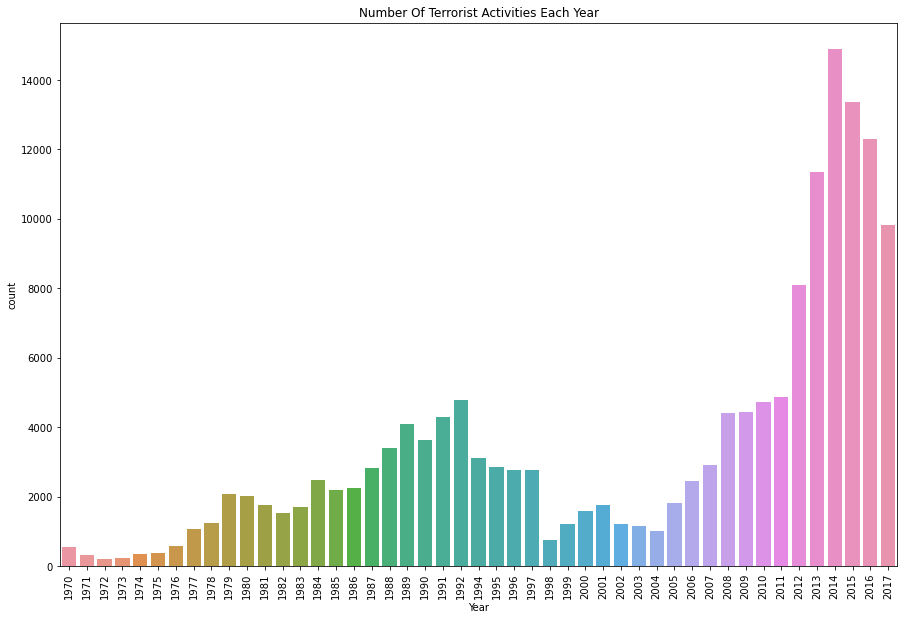

In [8]:
plt.figure(figsize=(15, 10))
sns.countplot(x="Year", data=df)
plt.xticks(rotation=90)
plt.title('Number Of Terrorist Activities Each Year')
plt.show()


<div class="alert alert-success" role="alert">
  <h2 class="alert-heading" style = "text-align:center">Observation</h2>
  <p style = 'color:red;font-size:1.75rem;text-align:center'>From the graph we can see 2013-17 marks the highest attacks with 2014 having the highest.</p>
  <hr>
</div>

## Counting the Yearly Casualities-

In [9]:
year_cas = df.groupby('Year').Casualities.sum().to_frame().reset_index()
year_cas.columns = ['Year','Casualities']
px.bar(data_frame=year_cas,x = 'Year',y = 'Casualities',color='Casualities',template='plotly_dark')

<div class="alert alert-success" role="alert">
  <h2 class="alert-heading" style = "text-align:center">Observation</h2>
  <p style = 'color:red;font-size:1.75rem;text-align:center'>It is observed that 2015 marks the highest Casualities records.</p>
  <hr>
</div>

## Type of Target Attacks

In [10]:
target = list(df['Target_type'])
target_map = dict(Counter(target))
target_df = pd.DataFrame(target_map.items())
target_df.columns = ['Target Type','Count']

In [11]:
px.bar(data_frame=target_df,x = 'Target Type',y = 'Count',color='Target Type',template='plotly_dark')

<div class="alert alert-success" role="alert">
  <h2 class="alert-heading" style = "text-align:center">Observation</h2>
  <p style = 'color:red;font-size:1.75rem;text-align:center'>Private Citizens and Property Counts the highest amongst all.</p>
  <hr>
</div>

# **Analysing the Type of Attacks:-**

In [32]:
#Counting the Casuallities according the Attack Type
AttackType=df.pivot_table(columns='AttackType',values='Casualities',aggfunc='sum')
AttackType = AttackType.T
AttackType['Type'] = AttackType.index

In [22]:
#plotting the Attack Type
labels = AttackType.columns.tolist()
attack=AttackType.T
values=attack.values.tolist()
values = sum(values,[])
attack_type = list(df['AttackType'].unique())
fig = go.Figure(data=[go.Pie(labels = attack_type,values=values,hole=.3)])
fig.update_layout(template = 'plotly_dark')
fig.show()

<div class="alert alert-success" role="alert">
  <h2 class="alert-heading" style = "text-align:center">Observation</h2>
  <p style = 'color:red;font-size:1.75rem;text-align:center'>Bombing and Explosion method shows the highest chossen type.

</p>
  <hr>
</div>

## Count of Weapon Chssen for Attack.

In [14]:
df.shape

(159946, 16)

In [15]:
from collections import Counter

In [16]:
values = list(df['AttackType'])
value_map = dict(Counter(values))
value_df = pd.DataFrame(value_map.items())
value_df.columns = ["AttackType","Count of Attack Type"]

In [17]:
px.bar(data_frame=value_df,x = 'AttackType',y = 'Count of Attack Type',color = 'AttackType',template="plotly_dark")

<div class="alert alert-success" role="alert">
  <h2 class="alert-heading" style = "text-align:center">Observation</h2>
  <p style = 'color:red;font-size:1.75rem;text-align:center'>Again, Bombing and Explosion shows the highest.</p>
  <hr>
</div>

## **Plotting the HOT-ZONE of Terrorism on the highest year of Terrorist Attack i.e. 2014.**

In [18]:
import folium
from folium.plugins import MarkerCluster
year=df[df['Year']==2014]
mapData=year.loc[:,'City':'longitude']
mapData=mapData.dropna().values.tolist()

map = folium.Map(location = [0, 50], tiles='CartoDB positron', zoom_start=2) 
markerCluster = folium.plugins.MarkerCluster().add_to(map)
for point in range(0, len(mapData)):
    folium.Marker(location=[mapData[point][1],mapData[point][2]],
                  popup = mapData[point][0]).add_to(markerCluster)
map

<div class="alert alert-success" role="alert">
  <h2 class="alert-heading" style = "text-align:center">Observation</h2>
  <p style = 'color:red;font-size:1.75rem;text-align:center'> IRAQ  shows the highest Terror Attacks followed by other Middle-east region.</p>
  <hr>
</div>

## Top 15 Countries showing the Highest Terror Attack.

In [25]:
plt.figure(figsize=(15,6))
country_attack=df.Country.value_counts()[:15].reset_index()
country_attack.columns= ["Country", "Total Attacks"]
px.bar(data_frame= country_attack,x = 'Country',y = 'Total Attacks',color = 'Country',template='plotly_dark')

<Figure size 1080x432 with 0 Axes>

<div class="alert alert-success" role="alert">
  <h2 class="alert-heading" style = "text-align:center">Observation</h2>
  <p style = 'color:red;font-size:1.75rem;text-align:center'>Iraq, again the highest followed by Pakistan, Afganistan and India.</p>
  <hr>
</div>

## Counting the Total Number of Casualities in each Country.

In [26]:
plt.figure(figsize=(15, 8))
cas_count= df.groupby("Country").Casualities.sum().to_frame().reset_index().sort_values("Casualities", ascending=False)[:15]
px.bar(data_frame=cas_count,x = 'Country',y = 'Casualities',color='Country',template='plotly_dark')

<Figure size 1080x576 with 0 Axes>

<div class="alert alert-success" role="alert">
  <h2 class="alert-heading" style = "text-align:center">Observation</h2>
  <p style = 'color:red;font-size:1.75rem;text-align:center'>Iraq, again the highest but this time followed by Afghainstan and Pakistan.</p>
  <hr>
</div>

## Count of Terror Attack Region-Wise.

In [31]:
region_attacks = df.Region.value_counts().to_frame().reset_index()
region_attacks.columns = ['Region', 'Total Attacks']
fig = px.bar_polar(data_frame=region_attacks,r = 'Total Attacks',theta='Region',color = 'Region',
                  template="plotly_dark", color_discrete_sequence= px.colors.sequential.Plasma_r)
fig.show()

<div class="alert alert-success" role="alert">
  <h2 class="alert-heading" style = "text-align:center">Observation</h2>
  <p style = 'color:red;font-size:1.75rem;text-align:center'>Middle East and North Africa shows the highest followed by South Asia.</p>
  <hr>
</div>

<div class="alert alert-info" role="alert">
  <h2 class="alert-heading" style = "text-align:center">Conclusion</h2>
  <p style = 'color:red;font-size:1.75rem;text-align:center'> This is a very simple Exploratory Data Analysis I performed. Many more aspects can be obtained from more detailed Analysis.</p>
  <hr>
</div>

 <div class="col-md-12 text-center">
        <a href="/">
            <button id="singlebutton" name="singlebutton" class="btn btn-outline-success my-2 my-sm-0">Go Back</button>
        </a>
    </div>

